In [223]:
import pandas as pd
import scanpy as sc
import numpy as np
import sys
import matplotlib.pyplot as plt

sys.path.insert(1, '/cndd3/dburrows/CODE/admin_tools/')
from admin_tools import admin_functions as adm

In [ ]:
/cndd3/dburrows/DATA/neurotransmitter_switch

# Pre-process data

In [24]:
data_path = '/cndd3/dburrows/DATA/neuroswitch/pilot/QY_2252_1_2'
adata = sc.read_10x_mtx(data_path)

#Calculate QC metrics
adata.var['mt'] = adata.var_names.str.startswith('mt-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
sc.pp.calculate_qc_metrics(adata, inplace=True)

In [25]:
adata

AnnData object with n_obs × n_vars = 19883 × 31053
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
    var: 'gene_ids', 'feature_types', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_mean_counts', 'log1p_total_counts'

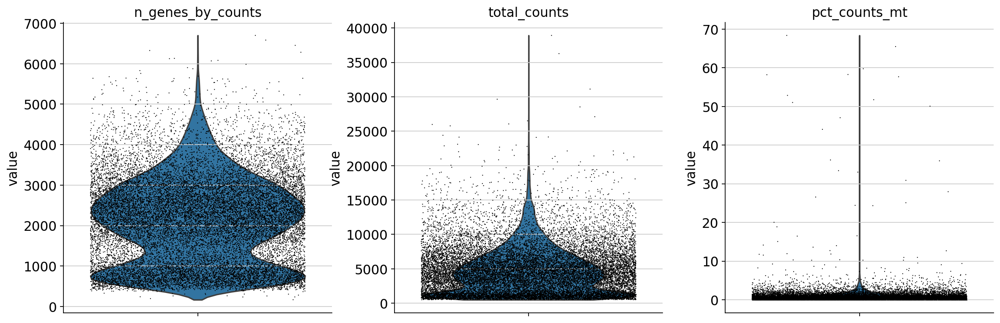

In [4]:
##QC -> by cell statistics
##========================
sc.set_figure_params(figsize=(8,5))

sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)


In [45]:
adata.obs['n_genes_by_counts'], adata.obs['total_counts'], adata.obs['pct_counts_mt']

(AAACCCAAGAGATCGC-1    2997
 AAACCCAAGAGCACTG-1    2317
 AAACCCAAGGAGATAG-1    2483
 AAACCCAAGGATCATA-1    2331
 AAACCCAAGGGAGGAC-1    1000
                       ... 
 TTTGTTGTCGTGGCGT-1    1800
 TTTGTTGTCTACGGTA-1    2018
 TTTGTTGTCTTCCAGC-1    3064
 TTTGTTGTCTTCTTCC-1    3057
 TTTGTTGTCTTGTTAC-1    2472
 Name: n_genes_by_counts, Length: 19883, dtype: int32,
 AAACCCAAGAGATCGC-1    7243.0
 AAACCCAAGAGCACTG-1    4674.0
 AAACCCAAGGAGATAG-1    5572.0
 AAACCCAAGGATCATA-1    4772.0
 AAACCCAAGGGAGGAC-1    1413.0
                        ...  
 TTTGTTGTCGTGGCGT-1    3126.0
 TTTGTTGTCTACGGTA-1    4070.0
 TTTGTTGTCTTCCAGC-1    7701.0
 TTTGTTGTCTTCTTCC-1    8154.0
 TTTGTTGTCTTGTTAC-1    5163.0
 Name: total_counts, Length: 19883, dtype: float32,
 AAACCCAAGAGATCGC-1    0.952644
 AAACCCAAGAGCACTG-1    0.171160
 AAACCCAAGGAGATAG-1    1.722900
 AAACCCAAGGATCATA-1    0.083822
 AAACCCAAGGGAGGAC-1    0.141543
                         ...   
 TTTGTTGTCGTGGCGT-1    0.895713
 TTTGTTGTCTACGGTA-1    0.245700

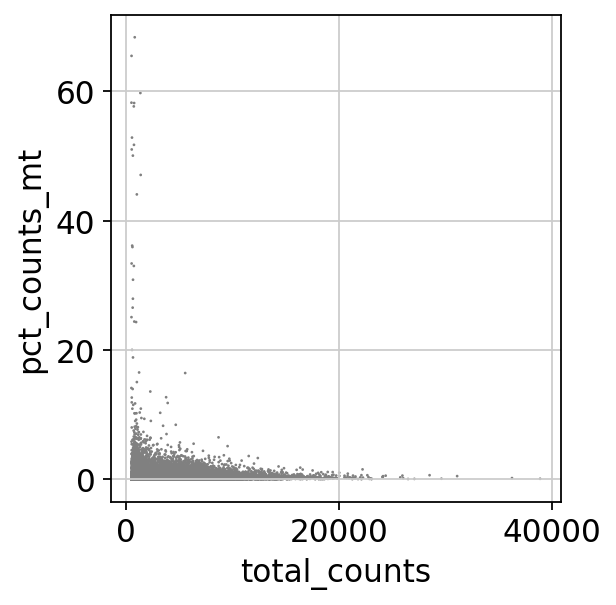

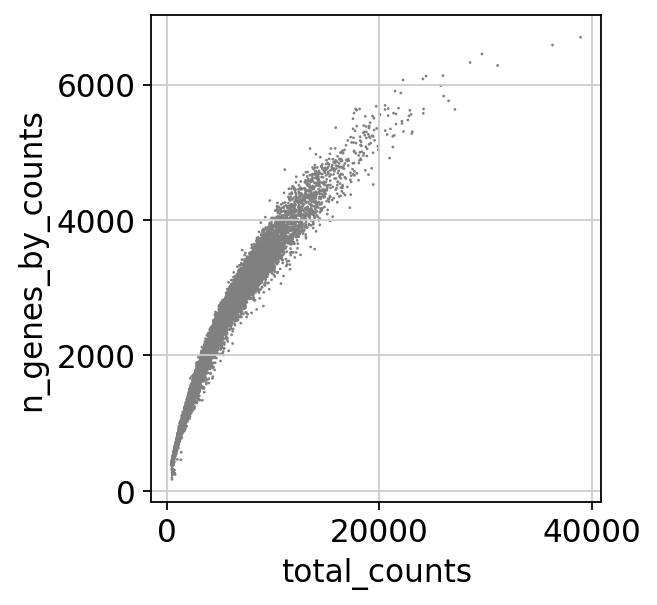

In [5]:
##QC -> by cell statistics; cell total counts x 
##========================
sc.set_figure_params(figsize=(4,4))
sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

In [26]:
#Process
##========================

#Filter based on QC
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_cells(adata, max_genes=5000)
sc.pp.filter_genes(adata, min_cells=3)
adata = adata[adata.obs.pct_counts_mt < 5, :]
adata.raw = adata


#Normalise
sc.pp.normalize_total(adata, target_sum=1e6)

#Log1p
sc.pp.log1p(adata)

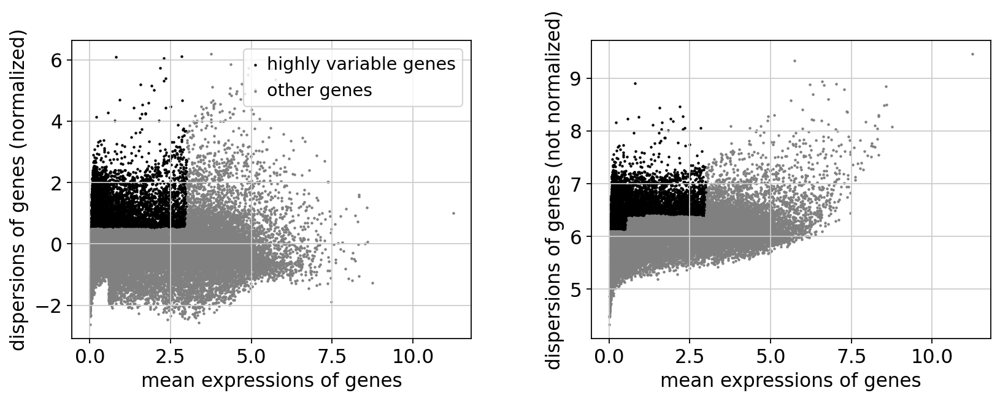

/tmp/ipykernel_1230064/491990853.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.var.highly_variable[i] = True


In [29]:
#Filter to only highly expressed + marker genes -> NB this may need to be tweaked
#Define marker genes
gaba_mark = ['Gad2', 'Gad1','Slc32a1']
glu_mark = ['Slc17a7', 'Slc17a6']
astro_mark = ['Gfap', 'Aldh1l1', 'S100b', 'Aqp4']
oli_mark = ['Mbp', 'Mog', 'Cnp', 'Plp1','Sox10', 'Olig2', 'Olig1']
mi_mark = ['Aif1', 'Cd68', 'Tmem119', 'P2ry12', 'Ptprc']
opc_mark = ['Sox10', 'Olig2', 'Olig1']

comb_l = gaba_mark+glu_mark+astro_mark+oli_mark+mi_mark+opc_mark

#Plot variable vs non variable genes
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(adata)

#Add in all marker genes
for i in comb_l:
    if adata.var.highly_variable[i] == False: 
        adata.var.highly_variable[i] = True

#Retain only most variable genes
fdata = adata[:,adata.var.highly_variable]
# sc.pp.regress_out(fdata, ['total_counts', 'pct_counts_mt'])
# sc.pp.scale(fdata, max_value=10)


In [30]:
fdata

View of AnnData object with n_obs × n_vars = 19644 × 4415
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'n_genes'
    var: 'gene_ids', 'feature_types', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_mean_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg'

/home/dburrows/mambaforge/envs/base_conda/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


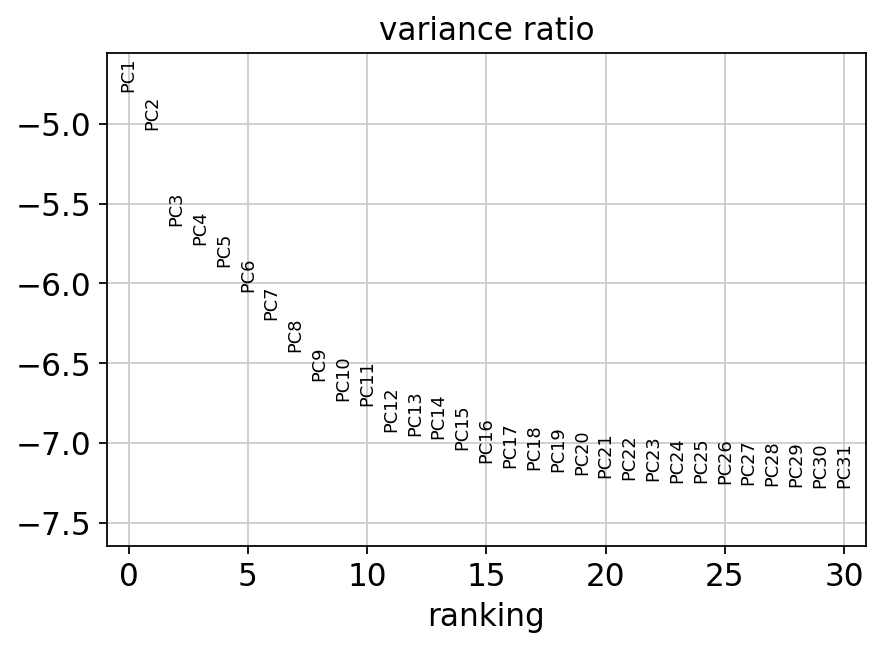

In [32]:
#PCA
sc.set_figure_params(figsize=(6,4))
sc.pp.scale(fdata, max_value=20) #scale data for PCA
sc.tl.pca(fdata, svd_solver='arpack')
sc.pl.pca_variance_ratio(fdata, log=True)

In [33]:
fdata.shape, adata.raw.shape

((19644, 4415), (19644, 23366))

In [36]:
#Do doublet detection with scrublet
import anndata as ad

# Create a new AnnData object from adata.raw
adata_raw = ad.AnnData(X=adata.raw.X, var=adata.raw.var, obs=adata.obs)
sc.external.pp.scrublet(adata_raw)

fdata.obs['doublet_score_raw'] = adata_raw.obs['doublet_score']
fdata.obs['predicted_doublets_raw'] = adata_raw.obs['predicted_doublet']

/home/dburrows/mambaforge/envs/base_conda/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.10
Detected doublet rate = 14.6%
Estimated detectable doublet fraction = 84.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 17.2%


In [41]:
fdata

AnnData object with n_obs × n_vars = 19644 × 4415
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'n_genes', 'doublet_score_raw', 'predicted_doublets_raw'
    var: 'gene_ids', 'feature_types', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_mean_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'

# Cluster data

In [44]:
#UMAP embedding
sc.pp.neighbors(fdata, n_neighbors=10, n_pcs=20)
sc.tl.umap(fdata)
#Louvain clustering
sc.tl.louvain(fdata)

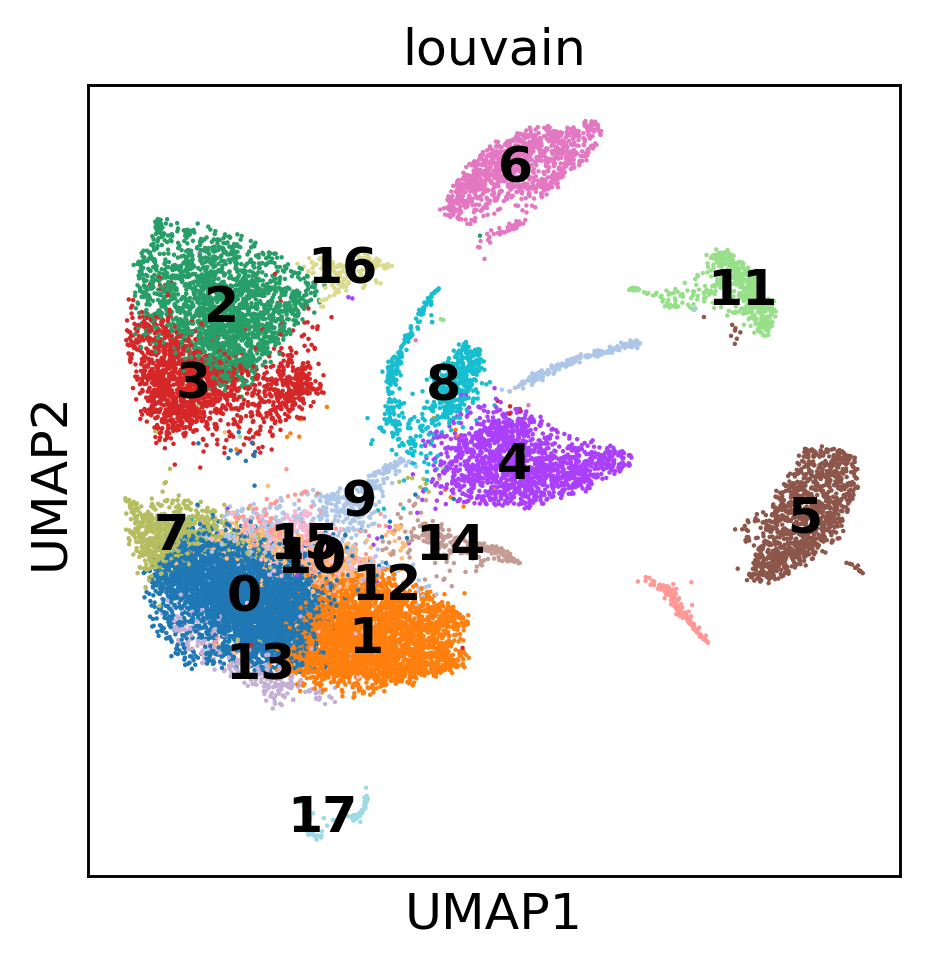

In [45]:
# UMAP by cluster, glu and gaba markers
sc.set_figure_params(figsize=(3,3))
sc.set_figure_params(dpi=130)
sc.pl.umap(fdata,color=['louvain'],legend_loc='on data')

In [118]:
fdata.obs

,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,log1p_n_genes_by_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,n_genes,louvain
AAACCCAAGAGATCGC-1,2997,7243.0,69.0,0.952644,8.005701,8.887929,24.451194,31.630540,41.184592,56.633991,2997,1
AAACCCAAGAGCACTG-1,2317,4674.0,8.0,0.171160,7.748460,8.449985,22.635858,30.124091,39.602054,55.862217,2317,9
AAACCCAAGGAGATAG-1,2483,5572.0,96.0,1.722900,7.817625,8.625689,24.982053,33.094042,42.552046,58.722182,2483,8
AAACCCAAGGATCATA-1,2331,4772.0,4.0,0.083822,7.754482,8.470731,24.937133,32.732607,42.015926,57.439229,2331,4
AAACCCAAGGGAGGAC-1,1000,1413.0,2.0,0.141543,6.908755,7.254178,22.009908,30.148620,43.382873,64.614296,1000,11
...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGTCGTGGCGT-1,1800,3126.0,28.0,0.895713,7.496097,8.047830,23.448496,30.454255,40.211132,58.413308,1800,3
TTTGTTGTCTACGGTA-1,2018,4070.0,10.0,0.245700,7.610358,8.311644,28.476658,35.577396,44.471744,60.884521,2018,0
TTTGTTGTCTTCCAGC-1,3064,7701.0,44.0,0.571354,8.027803,8.949235,25.788859,33.580055,42.397091,56.966628,3064,1
TTTGTTGTCTTCTTCC-1,3057,8154.0,13.0,0.159431,8.025516,9.006387,30.623007,38.091734,46.357616,59.946039,3057,4


In [329]:
fdata.X

array([[-0.02998472, -0.01865163, -0.22956635, ..., -0.01228683,
        -0.18945199, -0.03870282],
       [-0.02998472, -0.01865163, -0.22956635, ..., -0.01228683,
        -0.18945199, -0.03870282],
       [-0.02998472, -0.01865163, -0.22956635, ..., -0.01228683,
        -0.18945199, -0.03870282],
       ...,
       [-0.02998472, -0.01865163, -0.22956635, ..., -0.01228683,
        -0.18945199, -0.03870282],
       [-0.02998472, -0.01865163, -0.22956635, ..., -0.01228683,
        -0.18945199, -0.03870282],
       [-0.02998472, -0.01865163, -0.22956635, ..., -0.01228683,
        -0.18945199, -0.03870282]], dtype=float32)

In [42]:
fdata

AnnData object with n_obs × n_vars = 19644 × 4415
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'n_genes', 'doublet_score_raw', 'predicted_doublets_raw'
    var: 'gene_ids', 'feature_types', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_mean_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'

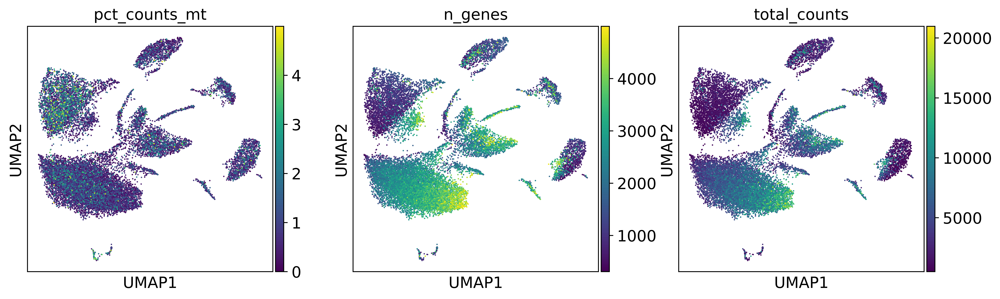

In [48]:
# UMAP by cluster, sample and donor
sc.set_figure_params(figsize=(18,14))
sc.set_figure_params(dpi=500)
sc.pl.umap(fdata,color=['pct_counts_mt', 'n_genes', 'total_counts'],legend_loc='on data')

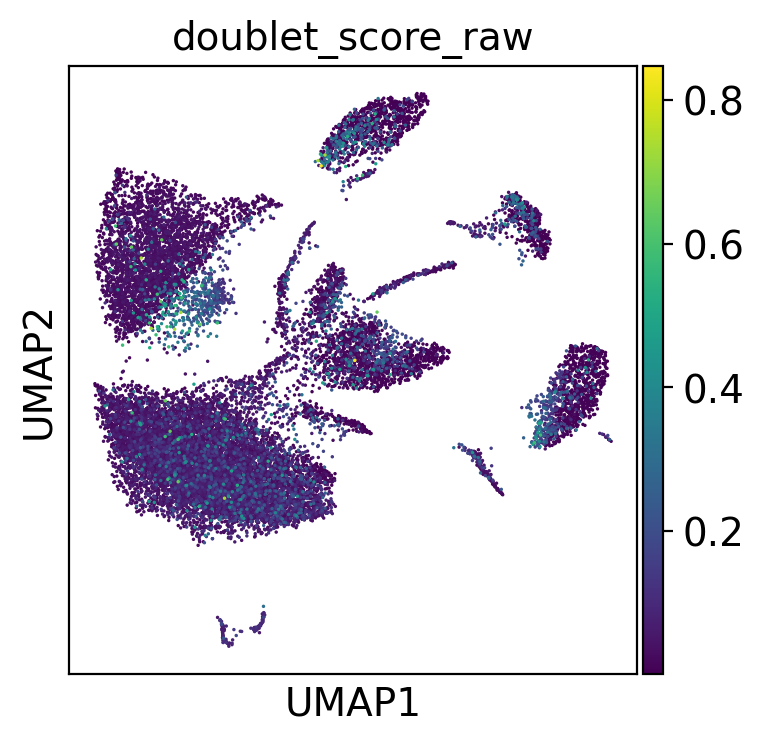

In [78]:
# UMAP by cluster, sample and donor
sc.set_figure_params(figsize=(18,14))
sc.set_figure_params(dpi=100)
sc.pl.umap(fdata,color=['doublet_score_raw'],legend_loc='on data')

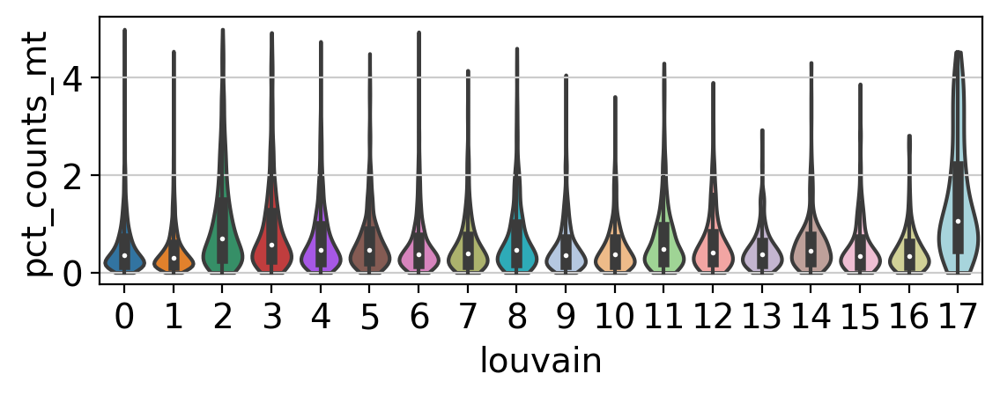

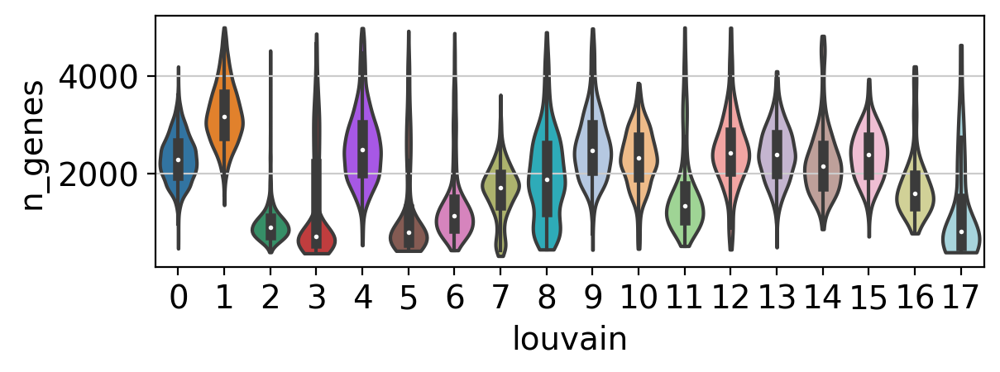

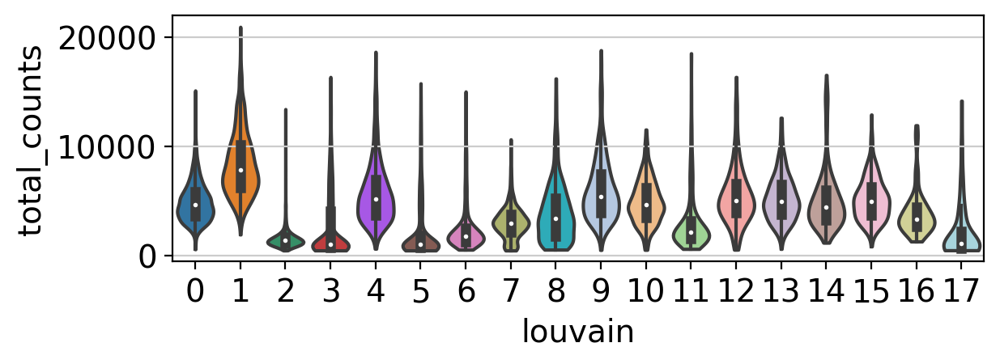

In [133]:
import seaborn as sns
from matplotlib.pyplot import rc_context
# Cluster metrics

with rc_context({'figure.figsize': (6, 2)}):
    sc.pl.violin(fdata, ['pct_counts_mt'], groupby='louvain', stripplot=False, inner='box')  
    
with rc_context({'figure.figsize': (6, 2)}):
    sc.pl.violin(fdata, ['n_genes'], groupby='louvain', stripplot=False, inner='box')  

with rc_context({'figure.figsize': (6, 2)}):
    sc.pl.violin(fdata, ['total_counts'], groupby='louvain', stripplot=False, inner='box')  


/tmp/ipykernel_1230064/413951095.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  curr['predicted_doublets_raw'] = curr['predicted_doublets_raw'].astype(int)


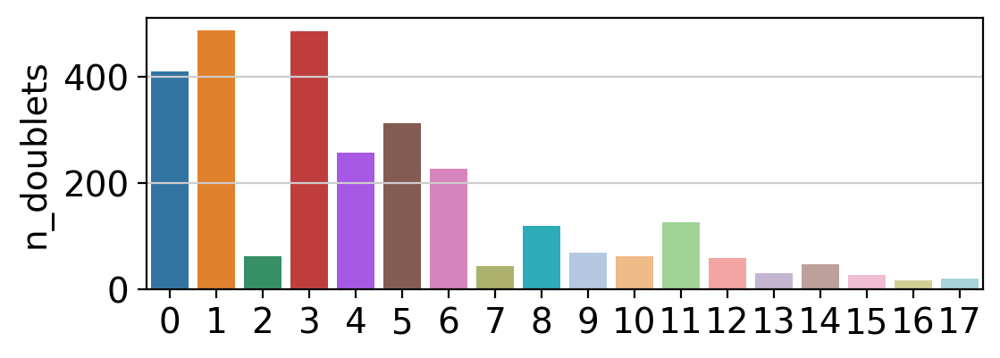

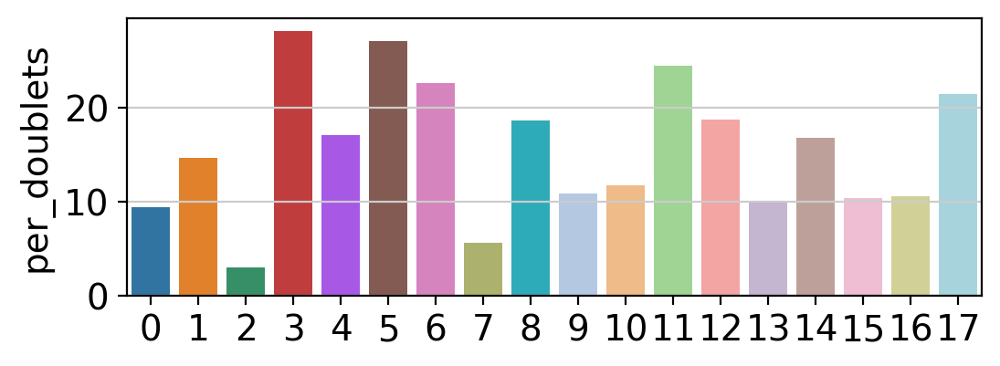

In [139]:
#plot doublets 
d_ = np.unique(fdata.obs['louvain'].values, return_counts=True)
sort1,sort2 = adm.sort_2list(d_[0].astype(int), d_[1])

curr = fdata.obs[['predicted_doublets_raw','louvain']]
curr['predicted_doublets_raw'] = curr['predicted_doublets_raw'].astype(int)
n_dub = curr.groupby('louvain').sum()['predicted_doublets_raw']
per_dub = (n_dub/sort2)*100

plot_df = pd.DataFrame({'n_doublets':n_dub, 'per_doublets': per_dub})
with rc_context({'figure.figsize': (6, 2)}):
    sns.barplot(x=np.arange(0,18), y=plot_df['n_doublets'])
plt.show()


with rc_context({'figure.figsize': (6, 2)}):
    sns.barplot(x=np.arange(0,18), y=plot_df['per_doublets'])
plt.show()


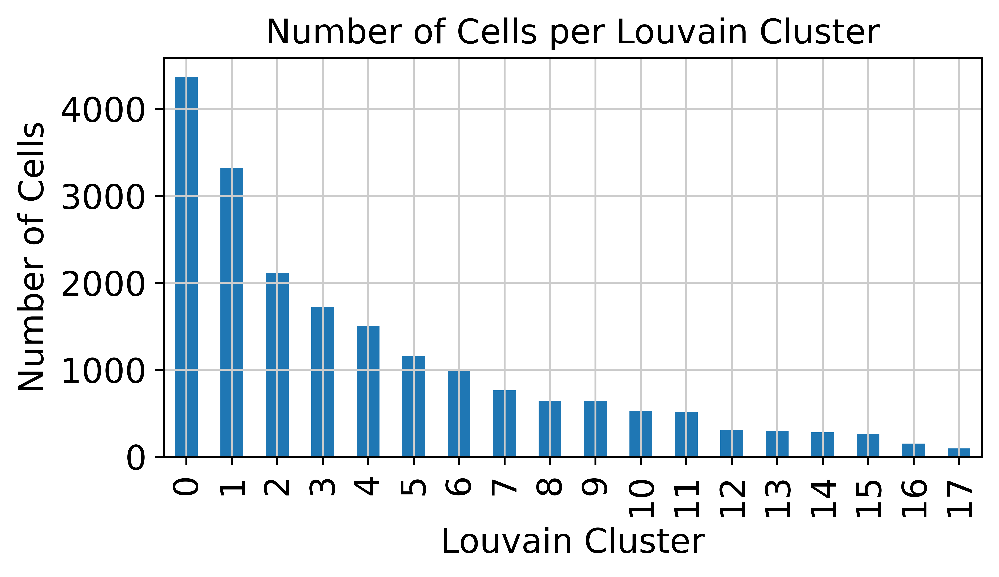

In [205]:
fig,ax = plt.subplots(figsize=(6,3))
cluster_counts = fdata.obs['louvain'].value_counts()

# Sort the clusters
cluster_counts = cluster_counts.sort_index()

# Create a bar plot
cluster_counts.plot(kind='bar')
plt.xlabel('Louvain Cluster')
plt.ylabel('Number of Cells')
plt.title('Number of Cells per Louvain Cluster')
plt.show()

In [148]:
fdata.obs

,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,log1p_n_genes_by_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,n_genes,doublet_score_raw,predicted_doublets_raw,louvain
AAACCCAAGAGATCGC-1,2997,7243.0,69.0,0.952644,8.005701,8.887929,24.451194,31.630540,41.184592,56.633991,2997,0.035755,False,1
AAACCCAAGAGCACTG-1,2317,4674.0,8.0,0.171160,7.748460,8.449985,22.635858,30.124091,39.602054,55.862217,2317,0.050678,False,9
AAACCCAAGGAGATAG-1,2483,5572.0,96.0,1.722900,7.817625,8.625689,24.982053,33.094042,42.552046,58.722182,2483,0.037831,False,0
AAACCCAAGGATCATA-1,2331,4772.0,4.0,0.083822,7.754482,8.470731,24.937133,32.732607,42.015926,57.439229,2331,0.137670,True,8
AAACCCAAGGGAGGAC-1,1000,1413.0,2.0,0.141543,6.908755,7.254178,22.009908,30.148620,43.382873,64.614296,1000,0.002144,False,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGTCGTGGCGT-1,1800,3126.0,28.0,0.895713,7.496097,8.047830,23.448496,30.454255,40.211132,58.413308,1800,0.027597,False,7
TTTGTTGTCTACGGTA-1,2018,4070.0,10.0,0.245700,7.610358,8.311644,28.476658,35.577396,44.471744,60.884521,2018,0.020921,False,1
TTTGTTGTCTTCCAGC-1,3064,7701.0,44.0,0.571354,8.027803,8.949235,25.788859,33.580055,42.397091,56.966628,3064,0.071493,False,1
TTTGTTGTCTTCTTCC-1,3057,8154.0,13.0,0.159431,8.025516,9.006387,30.623007,38.091734,46.357616,59.946039,3057,0.013353,False,4


Gaba: ['Gad2', 'Gad1', 'Slc32a1']
Glu: ['Slc17a7', 'Slc17a6']
Astro: ['Gfap', 'Aldh1l1', 'S100b', 'Aqp4']
Oli: ['Mbp', 'Mog', 'Cnp', 'Plp1', 'Sox10', 'Olig2', 'Olig1']
Micro: ['Aif1', 'Cd68', 'Tmem119', 'P2ry12', 'Ptprc']
OPC: ['Sox10', 'Olig2', 'Olig1']


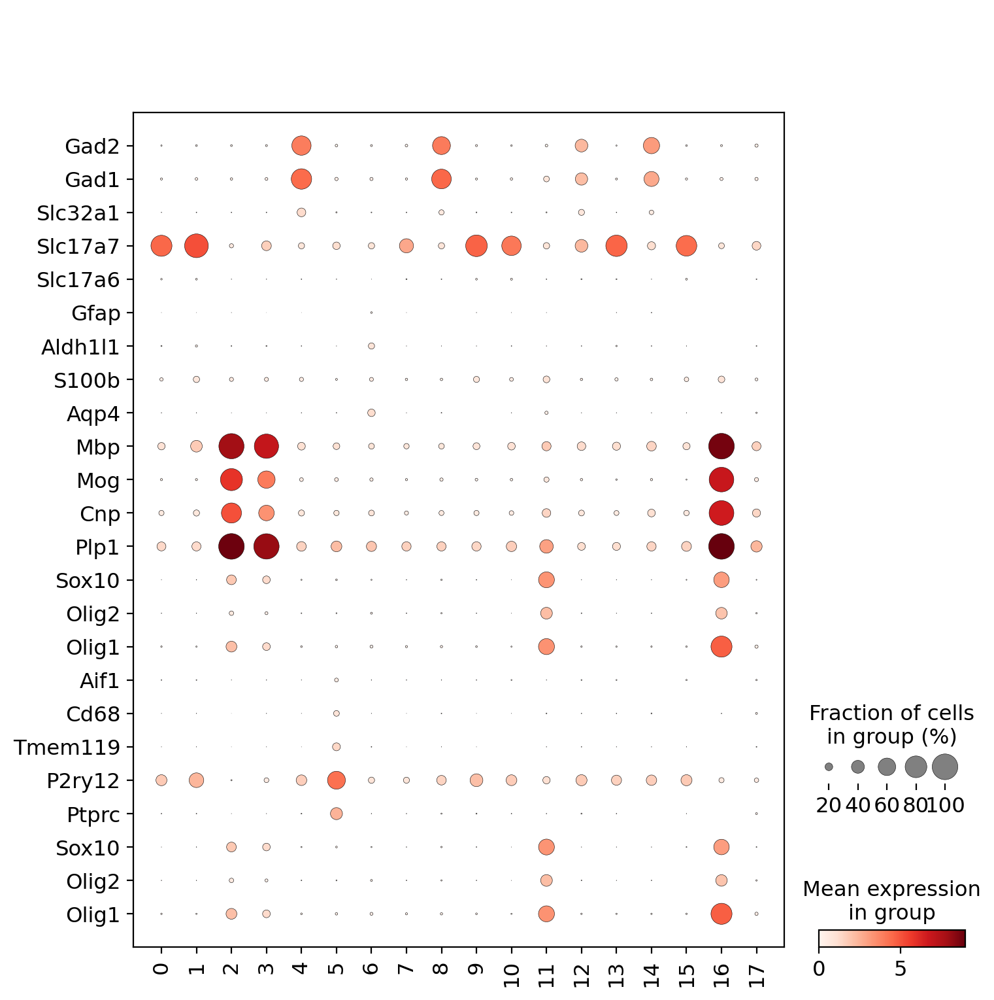

In [141]:
print_l = gaba_mark,glu_mark,astro_mark,oli_mark,mi_mark,opc_mark
name_l = ['Gaba','Glu','Astro', 'Oli', 'Micro', 'OPC']
for x,i in enumerate(print_l):print(f'{name_l[x]}: {i}')

# Look at expression of Gaba, Glu and glial marker cells -> QC by
# How selective are cluster for Gaba only

#Dotplot of gene expression by
sc.pl.dotplot(fdata,var_names=list(comb_l),
              groupby='louvain',swap_axes=True)


In [170]:
glu_mark, gaba_mark

(['Slc17a7', 'Slc17a8', 'Slc17a6'], ['Gad2', 'Gad1', 'Slc32a1'])

In [352]:
#Calculate GLU + GABA + OLI mean exp
gaba_ind = [np.where(fdata.var.index.values == i)[0][0] for i in gaba_mark]
glu_ind = [np.where(fdata.var.index.values == i)[0][0] for i in glu_mark]
oli_ind = [np.where(fdata.var.index.values == i)[0][0] for i in oli_mark]
astro_ind = [np.where(fdata.var.index.values == i)[0][0] for i in astro_mark]
opc_ind = [np.where(fdata.var.index.values == i)[0][0] for i in opc_mark]
mi_ind = [np.where(fdata.var.index.values == i)[0][0] for i in mi_mark]
glu_ind, gaba_ind, oli_ind, astro_ind, opc_ind, mi_ind

([1895, 1913],
 [312, 400, 549],
 [4261, 4090, 3240, 712, 3757, 3948, 3949],
 [3264, 1640, 2233, 4197],
 [3757, 3948, 3949],
 [4075, 3114, 1385, 796, 179])

In [156]:
##for each cell calculate mean GLU vs GABA expression
fdata.obs['mean_glu']  = np.mean(fdata.X[:,glu_ind],axis=1)
fdata.obs['mean_gaba']  = np.mean(fdata.X[:,gaba_ind],axis=1)
fdata.obs['mean_oli']  = np.mean(fdata.X[:,oli_ind],axis=1)
fdata.obs['mean_opc']  = np.mean(fdata.X[:,opc_ind],axis=1)
fdata.obs['mean_astro']  = np.mean(fdata.X[:,astro_ind],axis=1)
fdata.obs['mean_mi']  = np.mean(fdata.X[:,mi_ind],axis=1)

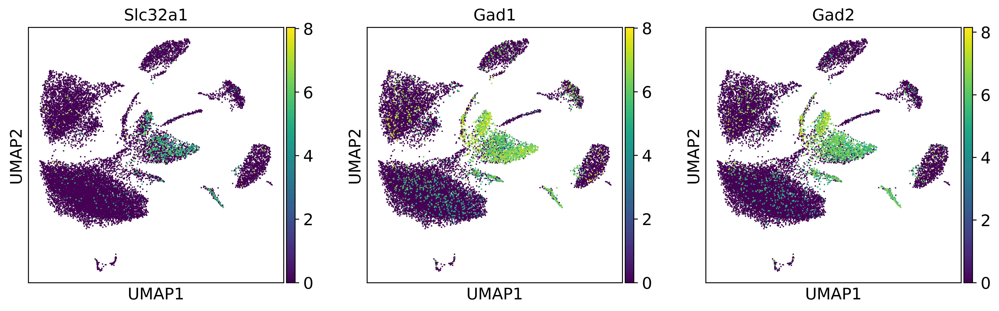

In [210]:
# Visualise GABA marker expression
# UMAP by cluster, sample and donor
sc.set_figure_params(figsize=(6,6))
sc.set_figure_params(dpi=300)
sc.pl.umap(fdata,color=['Slc32a1', 'Gad1', 'Gad2'],legend_loc='on data')

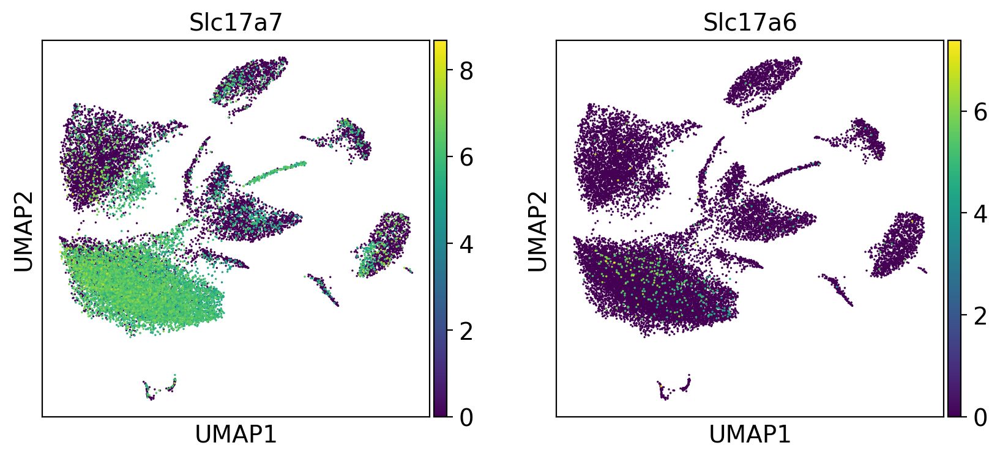

In [215]:
# Visualise GLU marker expression
# UMAP by cluster, sample and donor
sc.set_figure_params(figsize=(4,4))
sc.set_figure_params(dpi=100)
sc.pl.umap(fdata,color=['Slc17a7', 'Slc17a6'],legend_loc='on data')

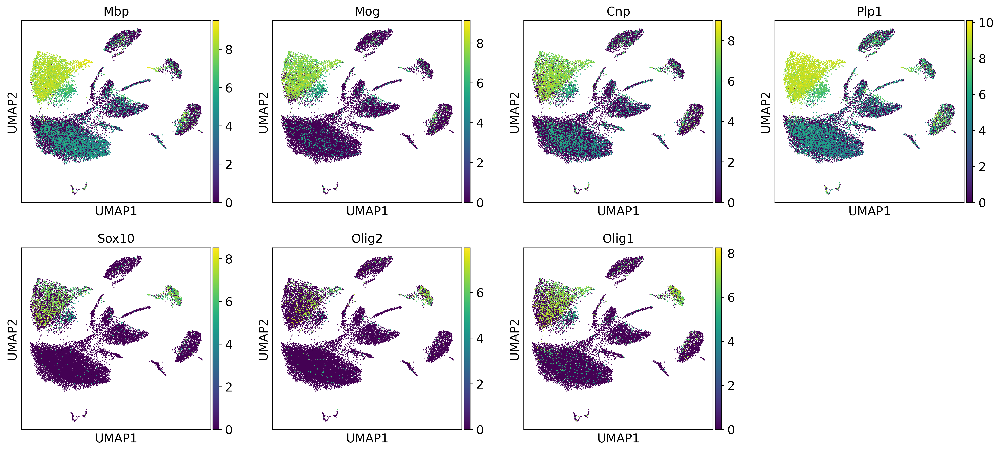

In [216]:
# Visualise OLI marker expression
# UMAP by cluster, sample and donor
sc.set_figure_params(figsize=(6,6))
sc.set_figure_params(dpi=200)
sc.pl.umap(fdata,color=oli_mark,legend_loc='on data')

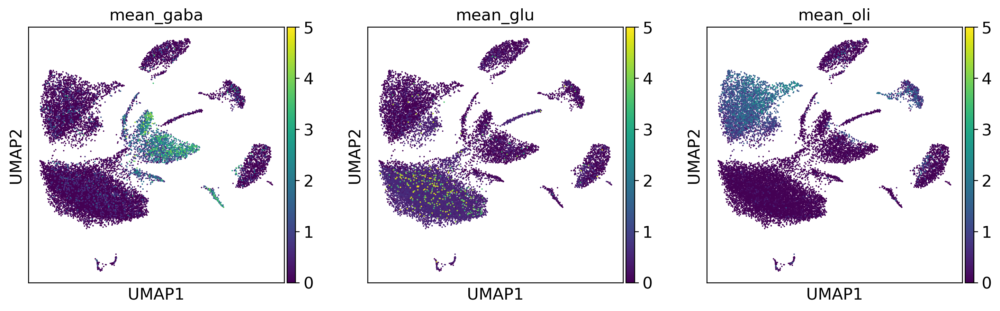

In [217]:
# Visualise mean expression for each cell type
# UMAP by cluster, sample and donor
sc.set_figure_params(figsize=(6,6))
sc.set_figure_params(dpi=120)
sc.pl.umap(fdata,color=['mean_gaba', 'mean_glu', 'mean_oli'],vmin = 0, vmax=5,legend_loc='on data')

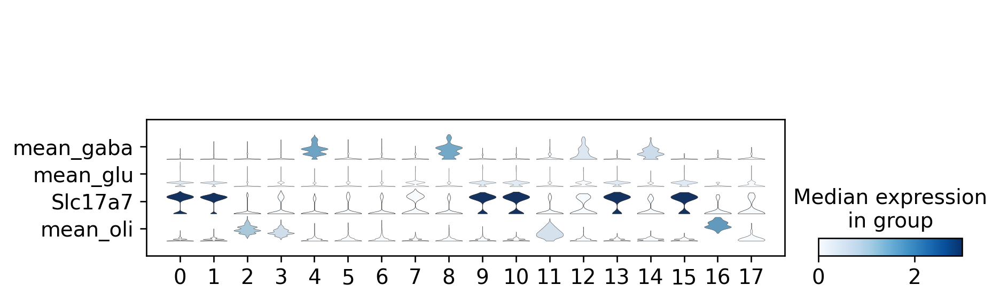

In [229]:
# Plot mean celltype expression for each cluster on joint violin

ax = sc.pl.stacked_violin(fdata,['mean_gaba', 'mean_glu', 'Slc17a7', 'mean_oli'],groupby='louvain', vmin=0, vmax=3,swap_axes=True)


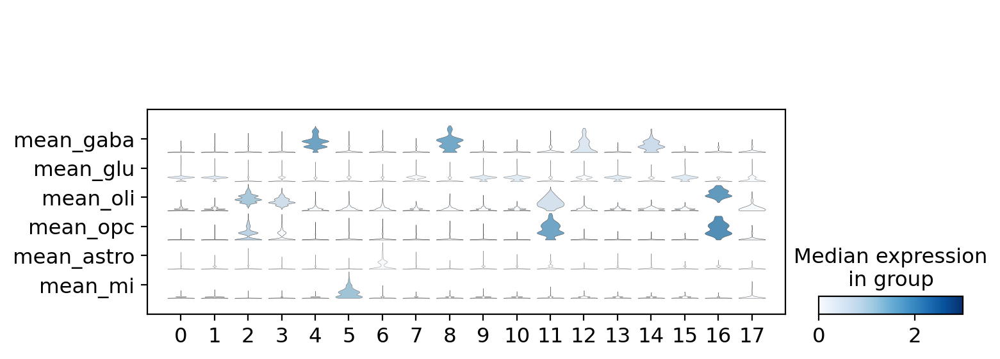

In [157]:
# Plot mean celltype expression for each cluster on joint violin
ax = sc.pl.stacked_violin(fdata,['mean_gaba', 'mean_glu', 'mean_oli', 'mean_opc', 'mean_astro', 'mean_mi'],groupby='louvain', vmin=0, vmax=3,swap_axes=True)

In [395]:
#assign crude celltype
par_l = ['louvain','mean_gaba', 'mean_glu', 'mean_oli', 'mean_opc', 'mean_astro', 'mean_mi']
curr_ = np.exp(fdata.obs[par_l].groupby('louvain').mean())
max_values = curr_.max(axis=1)
max_columns = curr_.idxmax(axis=1)

# Combine the results into a new DataFrame
result_df = pd.DataFrame({'MaxValue': max_values, 'MaxColumn': max_columns})
result_df['ncells'] = sort2
result_df = result_df[result_df['MaxValue'] > 1]
result_df['MaxColumn'] = [i.split('_')[-1] for i in result_df['MaxColumn']]
result_df

,MaxValue,MaxColumn,ncells
louvain,,,
0,1.381350,glu,4367
1,1.525340,glu,3320
2,3.274860,oli,2114
3,2.179935,oli,1723
4,4.664303,gaba,1503
5,3.853877,mi,1154
6,2.092577,astro,1003
8,3.928151,gaba,637
9,1.411312,glu,637


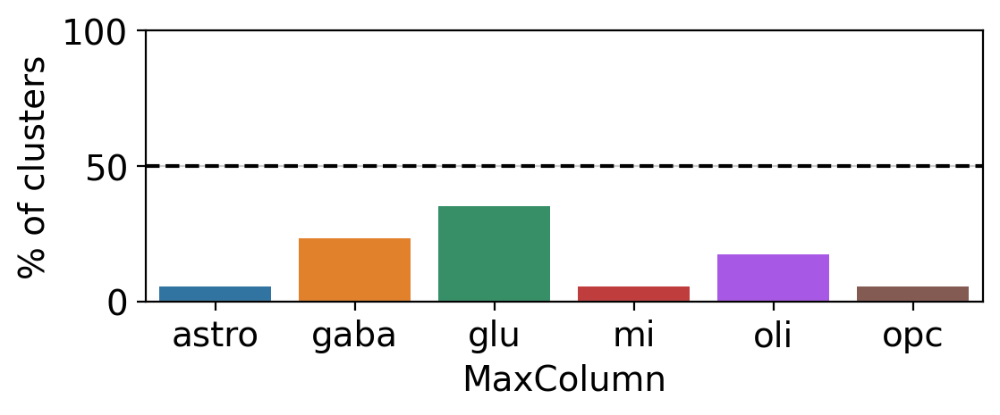

In [226]:
#plot n celltypes across data
#plot by clusters

with rc_context({'figure.figsize': (6, 2)}):
    sns.barplot(x=result_df.groupby('MaxColumn').count().index, y=(result_df.groupby('MaxColumn').count()['MaxValue']/17)*100)
plt.ylabel('% of clusters')
plt.ylim(0,100)
plt.axhline(y=50, color='k', linestyle='--')
plt.show()


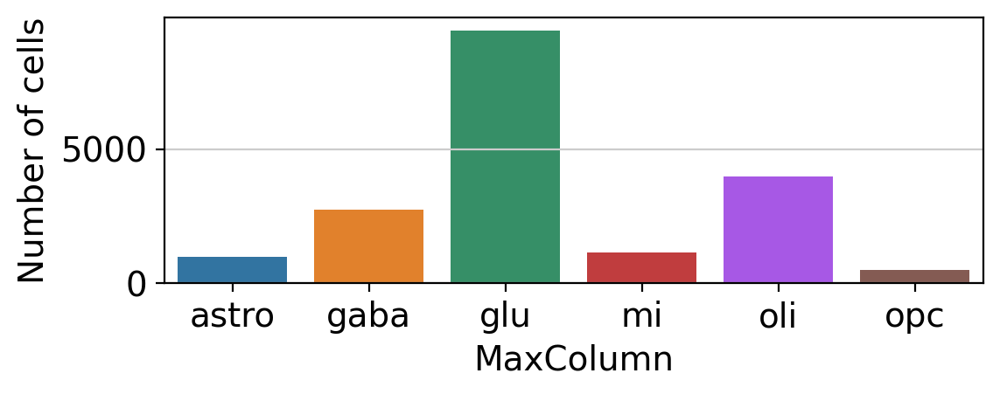

In [222]:
#plot n celltypes across data
#plot total cell types

with rc_context({'figure.figsize': (6, 2)}):
    sns.barplot(x=result_df.groupby('MaxColumn').count().index, y=result_df.groupby('MaxColumn').sum()['ncells'])
plt.ylabel('Number of cells')
plt.show()



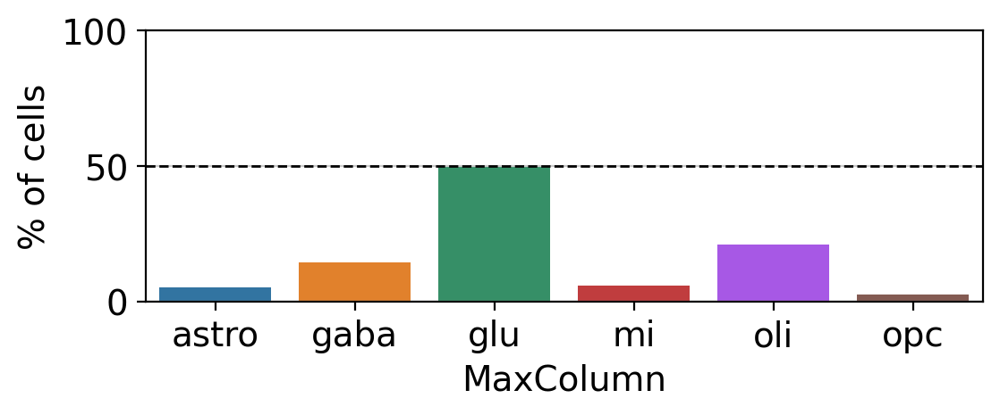

In [227]:
#plot n celltypes across data
#percentage of all cells

with rc_context({'figure.figsize': (6, 2)}):
    sns.barplot(x=result_df.groupby('MaxColumn').count().index, y=(result_df.groupby('MaxColumn').sum()['ncells']/sum(result_df.groupby('MaxColumn').sum()['ncells']))*100)
plt.ylabel('% of cells')
plt.ylim(0,100)b

plt.axhline(y=50, color='k', linestyle='--', linewidth=1)
plt.show()

In [398]:
result_df.groupby('MaxColumn').count()['MaxValue']/17*100

MaxColumn
astro     5.882353
gaba     23.529412
glu      35.294118
mi        5.882353
oli      17.647059
opc       5.882353
Name: MaxValue, dtype: float64

In [399]:
import pandas as pd

# Data for the first set
data_pilot = {
    'cell type': ['astro', 'gaba', 'glu', 'mi', 'oli', 'opc'],
    'cpm': [5.882353, 23.529412, 35.294118, 5.882353, 17.647059, 5.882353]
}

# Data for the second set
data_macosko = {
    'cell type': ['astro', 'gaba', 'glu', 'mi', 'oli', 'opc'],
    'cpm': [23.529412, 29.411765, 70.588235, 17.647059, 11.764706, 17.647059]
}


# Convert to DataFrames
df_pilot = pd.DataFrame(data_pilot)
df_macosko = pd.DataFrame(data_macosko)

# Add a label column
df_pilot['label'] = 'pilot'
df_macosko['label'] = 'macosko'

# Concatenate the DataFrames
combined_df = pd.concat([df_pilot, df_macosko])

# The combined DataFrame is ready
combined_df

,cell type,cpm,label
0,astro,5.882353,pilot
1,gaba,23.529412,pilot
2,glu,35.294118,pilot
3,mi,5.882353,pilot
4,oli,17.647059,pilot
5,opc,5.882353,pilot
0,astro,23.529412,macosko
1,gaba,29.411765,macosko
2,glu,70.588235,macosko
3,mi,17.647059,macosko


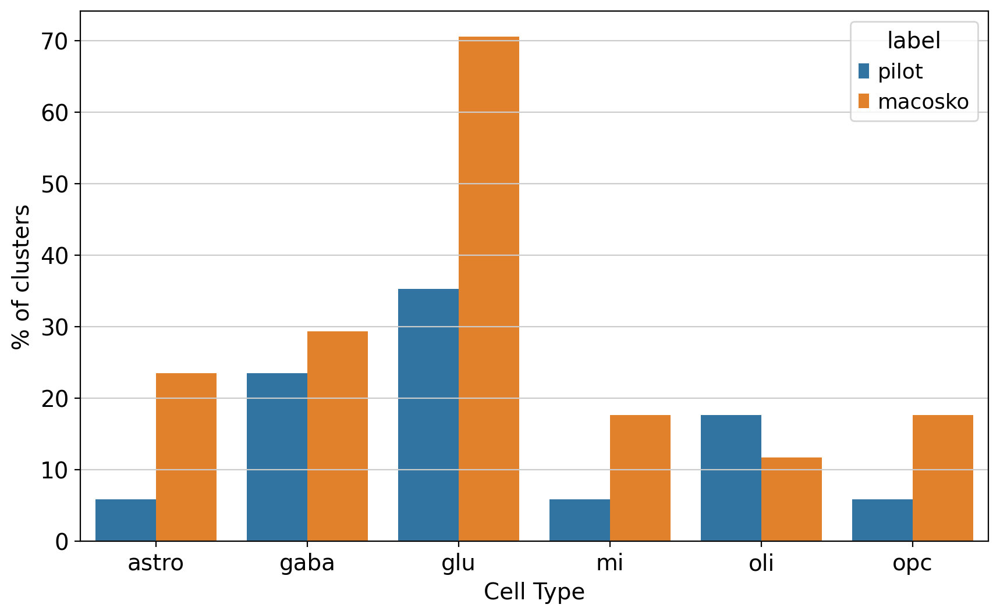

In [400]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming 'combined_df' is your DataFrame

# Create the bar plot
plt.figure(figsize=(10, 6))
sns.barplot(data=combined_df, x='cell type', y='cpm', hue='label')

plt.xlabel('Cell Type')
plt.ylabel('% of clusters')
plt.show()


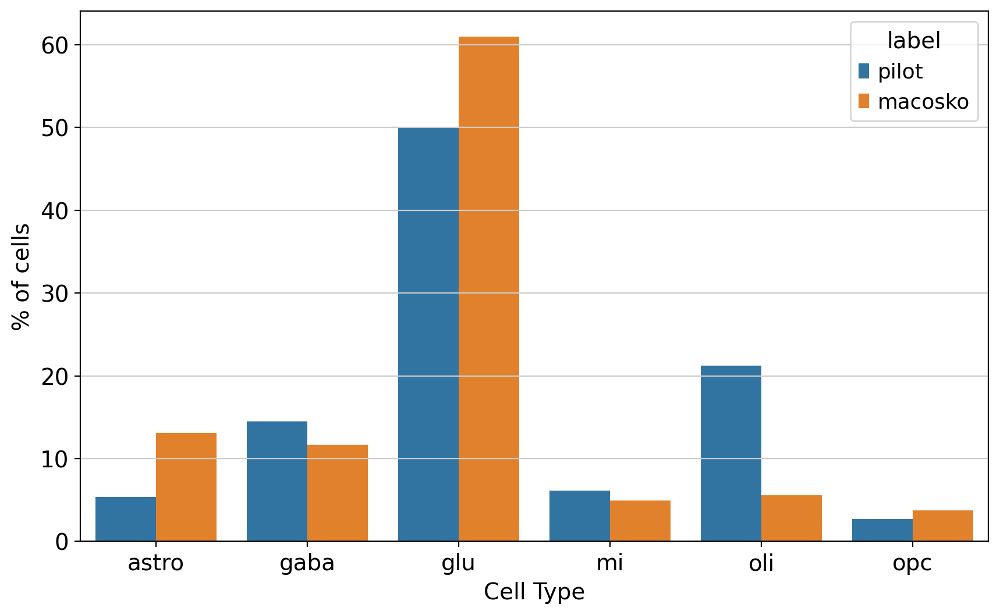

In [394]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming 'combined_df' is your DataFrame

# Create the bar plot
plt.figure(figsize=(10, 6))
sns.barplot(data=combined_df, x='cell type', y='cpm', hue='label')

plt.xlabel('Cell Type')
plt.ylabel('% of cells')
plt.show()


In [341]:
#Compare mean CPM values with AIBS
path= '/cndd3/dburrows/DATA/neurotransmitter_switch/'
aibs = pd.read_csv(path + 'medians.csv', index_col=0)
aibs

,108_Pvalb,229_L6 IT CTX,26_Ntng1 HPF,67_Sst,6_Lamp5 Lhx6,111_Pvalb,359_CA2-IG-FC,238_Car3,347_CA1-do,381_SMC-Peri,...,50_Vip,190_L4/5 IT CTX,207_L5/6 IT CTX,342_CA1,260_L5 PT CTX,324_ProS,178_L4 IT CTX,284_L6 CT CTX,377_Astro,298_L6 CT ENT
feature,,,,,,,,,,,,,,,,,,,,,
0610005C13Rik,0.000,0.000,0.00,0.000,0.000,0.00,0.000,0.00,0.00,0.0,...,0.000,0.000,0.000,0.00,0.000,0.000,0.00,0.00,0.00,0.00
0610006L08Rik,0.000,0.000,0.00,0.000,0.000,0.00,0.000,0.00,0.00,0.0,...,0.000,0.000,0.000,0.00,0.000,0.000,0.00,0.00,0.00,0.00
0610007P14Rik,6.205,6.865,6.51,6.345,6.720,6.10,6.885,7.12,6.42,3.3,...,6.550,6.275,6.615,6.91,6.220,6.745,6.46,6.62,7.74,6.58
0610009B22Rik,6.490,6.380,7.07,6.610,6.845,6.59,6.045,6.37,6.26,0.0,...,6.425,5.965,6.170,6.49,6.235,6.615,6.14,6.67,2.70,6.05
0610009E02Rik,0.000,0.000,0.00,0.000,0.000,0.00,0.000,0.00,0.00,0.0,...,0.000,0.000,0.000,0.00,0.000,0.000,0.00,0.00,0.00,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
n-R5s142,0.000,0.000,0.00,0.000,0.000,0.00,0.000,0.00,0.00,0.0,...,0.000,0.000,0.000,0.00,0.000,0.000,0.00,0.00,0.00,0.00
n-R5s143,0.000,0.000,0.00,0.000,0.000,0.00,0.000,0.00,0.00,0.0,...,0.000,0.000,0.000,0.00,0.000,0.000,0.00,0.00,0.00,0.00
n-R5s144,0.000,0.000,0.00,0.000,0.000,0.00,0.000,0.00,0.00,0.0,...,0.000,0.000,0.000,0.00,0.000,0.000,0.00,0.00,0.00,0.00


In [280]:
gaba_ind = result_df[result_df['MaxColumn'] == 'gaba'].index
sub_data = fdata[fdata.obs['louvain'].isin(['4', '8', '12', '14'])]


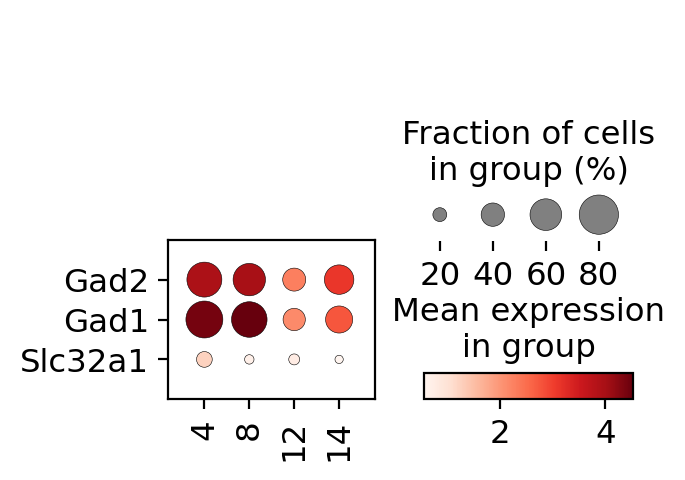

In [281]:
name_l = ['Gaba']

# Look at expression of Gaba, Glu and glial marker cells -> QC by
# How selective are cluster for Gaba only

#Dotplot of gene expression by
sc.pl.dotplot(sub_data,var_names=list(gaba_mark),
              groupby='louvain',swap_axes=True)

In [309]:
aibs[gaba_names].columns.unique()

Index(['Pvalb', 'Sst', 'Lamp5', 'Vip'], dtype='object')

In [310]:
aibs[gaba_names]

,Pvalb,Pvalb,Pvalb,Pvalb,Pvalb,Pvalb,Pvalb,Pvalb,Pvalb,Pvalb,...,Vip,Vip,Vip,Vip,Vip,Vip,Vip,Vip,Vip,Vip
feature,,,,,,,,,,,,,,,,,,,,,
0610005C13Rik,0.000,0.00,0.00,0.00,0.000,0.00,0.00,0.000,0.00,0.0,...,0.000,0.000,0.000,0.00,0.00,0.000,0.00,0.00,0.000,0.000
0610006L08Rik,0.000,0.00,0.00,0.00,0.000,0.00,0.00,0.000,0.00,0.0,...,0.000,0.000,0.000,0.00,0.00,0.000,0.00,0.00,0.000,0.000
0610007P14Rik,6.205,6.10,6.12,5.99,5.955,6.12,6.11,6.315,6.06,6.1,...,6.465,6.515,6.170,6.43,6.65,6.755,6.74,6.48,6.555,6.550
0610009B22Rik,6.490,6.59,6.59,6.58,6.925,6.53,6.65,6.515,6.62,6.6,...,6.330,5.980,5.875,6.04,6.50,6.200,6.49,6.02,6.350,6.425
0610009E02Rik,0.000,0.00,0.00,0.00,0.000,0.00,0.00,0.000,0.00,0.0,...,0.000,0.000,0.000,0.00,0.00,0.000,0.00,0.00,0.000,0.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
n-R5s142,0.000,0.00,0.00,0.00,0.000,0.00,0.00,0.000,0.00,0.0,...,0.000,0.000,0.000,0.00,0.00,0.000,0.00,0.00,0.000,0.000
n-R5s143,0.000,0.00,0.00,0.00,0.000,0.00,0.00,0.000,0.00,0.0,...,0.000,0.000,0.000,0.00,0.00,0.000,0.00,0.00,0.000,0.000
n-R5s144,0.000,0.00,0.00,0.00,0.000,0.00,0.00,0.000,0.00,0.0,...,0.000,0.000,0.000,0.00,0.00,0.000,0.00,0.00,0.000,0.000


In [311]:
# List of unique column names
unique_names = ['Pvalb', 'Sst', 'Lamp5', 'Vip']
df = aibs[gaba_names]

# Dictionary to hold the mean values for each unique name
mean_values = {}

# Calculate mean for each group and store in the dictionary
for name in unique_names:
    columns = [col for col in df.columns if col.startswith(name)]
    mean_values[name] = df[columns].mean(axis=1)

# Create a new DataFrame from the dictionary
mean_df = pd.DataFrame(mean_values)


In [332]:
df

,Pvalb,Pvalb,Pvalb,Pvalb,Pvalb,Pvalb,Pvalb,Pvalb,Pvalb,Pvalb,...,Vip,Vip,Vip,Vip,Vip,Vip,Vip,Vip,Vip,Vip
feature,,,,,,,,,,,,,,,,,,,,,
Gad2,9.730,9.46,8.81,9.060,8.38,8.79,9.31,8.285,8.745,8.92,...,10.120,9.660,8.62,8.90,9.565,9.540,8.340,7.98,8.475,7.78
Gad1,10.240,10.61,11.21,10.935,10.82,10.88,10.63,11.215,10.530,10.76,...,11.565,10.980,10.72,10.66,10.120,11.205,10.175,10.56,10.225,10.29
Slc32a1,5.735,5.78,5.77,5.770,6.32,5.79,5.70,5.815,5.675,5.63,...,5.900,5.445,5.41,5.27,4.915,5.400,5.110,5.06,5.570,5.69


In [336]:
adata.obs['clust'] = df.columns

In [339]:
adata

AnnData object with n_obs × n_vars = 71 × 3

/home/dburrows/mambaforge/envs/base_conda/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


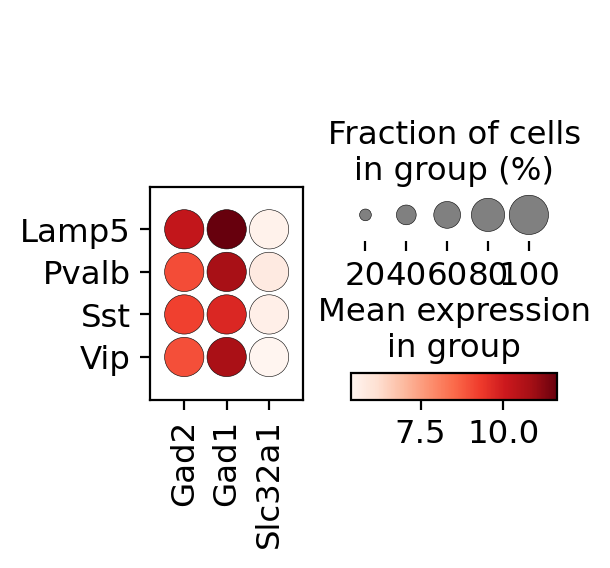

In [340]:
df = df.loc[gaba_mark]

df_transposed = df.T

# Create AnnData object
adata = ad.AnnData(X=df_transposed)

# Set the gene names (var_names) and cluster names (obs_names)
adata.var_names = df_transposed.columns
adata.obs_names = df_transposed.index
adata.obs['clust'] = df.columns

# Now you can use adata with Scanpy's dotplot function
sc.pl.dotplot(adata, var_names=adata.var_names, groupby='clust')

In [342]:
sub_ = mean_df.loc[gaba_mark]
sub_

,Pvalb,Sst,Lamp5,Vip
feature,,,,
Gad2,9.022143,9.220882,10.269444,8.962857
Gad1,10.799643,9.757206,11.646667,10.763571
Slc32a1,5.799643,5.615882,5.525000,5.392500


In [376]:
prac_df.iloc[:, :-1]

,Gad2,Gad1,Slc32a1
0,3.100877,2.892372,-0.183060
1,3.325013,-0.389604,-0.183060
2,3.086827,2.739542,-0.183060
3,2.714881,2.401137,4.310197
4,2.355537,2.074199,-0.183060
...,...,...,...
2723,-0.352471,-0.389604,-0.183060
2724,-0.352471,2.467631,5.873610
2725,3.354455,2.448443,-0.183060
2726,2.988114,2.312787,-0.183060


In [382]:
2**aibs

,108_Pvalb,229_L6 IT CTX,26_Ntng1 HPF,67_Sst,6_Lamp5 Lhx6,111_Pvalb,359_CA2-IG-FC,238_Car3,347_CA1-do,381_SMC-Peri,...,50_Vip,190_L4/5 IT CTX,207_L5/6 IT CTX,342_CA1,260_L5 PT CTX,324_ProS,178_L4 IT CTX,284_L6 CT CTX,377_Astro,298_L6 CT ENT
feature,,,,,,,,,,,,,,,,,,,,,
0610005C13Rik,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
0610006L08Rik,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
0610007P14Rik,73.771926,116.565739,91.139213,81.289663,105.419650,68.593502,118.192936,139.102062,85.627364,9.849155,...,93.701485,77.439622,98.019712,120.258912,74.542950,107.262353,88.034676,98.360012,213.782507,95.670352
0610009B22Rik,89.884472,83.285879,134.363736,97.680589,114.960944,96.335792,66.027723,82.710581,76.638637,1.000000,...,85.924640,62.466033,72.003743,89.884472,75.322031,98.019712,70.521927,101.828670,6.498019,66.256955
0610009E02Rik,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
n-R5s142,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
n-R5s143,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
n-R5s144,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


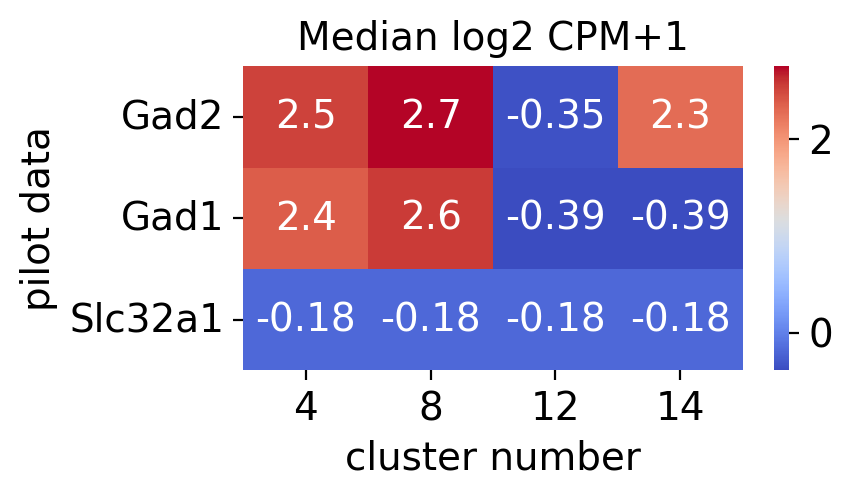

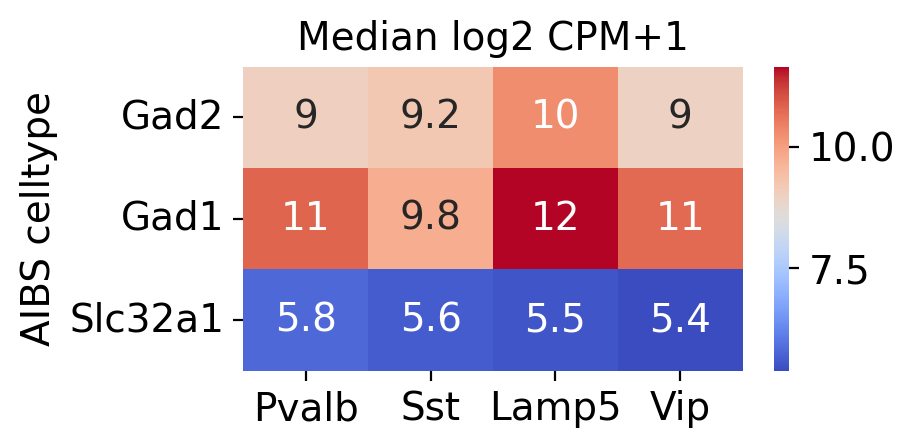

In [380]:
plt.figure(figsize=(4, 2))
sns.heatmap(prac_df.groupby('cluster number').median().T, annot=True, cmap='coolwarm')
plt.title('Median log2 CPM+1')
plt.ylabel('pilot data')
plt.show()

plt.figure(figsize=(4, 2))
sns.heatmap(sub_, annot=True, cmap='coolwarm')
plt.title('Median log2 CPM+1')
plt.ylabel('AIBS celltype')
plt.show()


In [355]:
sub_data.obs['louvain']

AAACCCAAGGATCATA-1     8
AAACCCATCGGCTGTG-1     4
AAACGAAGTGTTAAAG-1     4
AAACGAATCGCATTAG-1     4
AAACGAATCTGAATCG-1     4
                      ..
TTTGTTGAGCTGAAAT-1     4
TTTGTTGAGTGCCGAA-1    14
TTTGTTGCAACGTTAC-1     4
TTTGTTGGTGGGACAT-1     4
TTTGTTGTCTTCTTCC-1     4
Name: louvain, Length: 2728, dtype: category
Categories (4, object): ['4', '8', '12', '14']

In [379]:
prac_df = pd.DataFrame(columns = gaba_mark, data = sub_data.X[:,gaba_ind])
prac_df['cluster number'] = sub_data.obs['louvain'].values
prac_df.groupby('cluster number').median()

,Gad2,Gad1,Slc32a1
cluster number,,,
4,2.514049,2.376372,-0.18306
8,2.743998,2.552209,-0.18306
12,-0.352471,-0.389604,-0.18306
14,2.273028,-0.389604,-0.18306


In [363]:
prac_df

,Gad2,Gad1,Slc32a1,clust
0,3.100877,2.892372,-0.183060,8
1,3.325013,-0.389604,-0.183060,4
2,3.086827,2.739542,-0.183060,4
3,2.714881,2.401137,4.310197,4
4,2.355537,2.074199,-0.183060,4
...,...,...,...,...
2723,-0.352471,-0.389604,-0.183060,4
2724,-0.352471,2.467631,5.873610,14
2725,3.354455,2.448443,-0.183060,4
2726,2.988114,2.312787,-0.183060,4


In [349]:
gaba_ind

CategoricalIndex(['4', '8', '12', '14'], categories=['0', '1', '2', '3', '4', '5', '6', '7', ...], ordered=False, dtype='category', name='louvain')

In [316]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'mean_df' is your DataFrame with mean values
# Columns are 'Pvalb', 'Sst', 'Lamp5', 'Vip'

# Melt the DataFrame for plotting with Seaborn

# Create the dot plot
plt.figure(figsize=(10, 6))
sns.stripplot(data=mean_df_melted, x='value', y='variable', jitter=0.1)

plt.title('Dot Plot of Mean Values')
plt.xlabel('Mean Value')
plt.ylabel('Variable')
plt.show()

KeyError: 'index'

In [307]:
base_column_ aibs[gaba_names].columns.unique()

# Identify columns starting with the base name
repeated_cols = [col for col in df.columns if col.startswith(base_column_name)]

# Calculate mean across these columns for each row
df[base_column_name] = df[repeated_cols].mean(axis=1)

# Drop the original repeated columns
df.drop(columns=repeated_cols, inplace=True)

# Now 'df' has the mean values in a single column named 'A'

Index(['Pvalb', 'Sst', 'Lamp5', 'Vip'], dtype='object')

In [304]:
aibs.columns = np.asarray([i.split('_')[-1] for i in aibs.columns])
gaba_names = ['Pvalb', 'Sst', 'Lamp5', 'Vip']
#Dotplot of gene expression by
sc.pl.dotplot(aibs,var_names=list(gaba_names),
              groupby='louvain',swap_axes=True)


AttributeError: 'DataFrame' object has no attribute '_sanitize'

In [294]:
aibs.columns.unique()

Index(['Pvalb', 'L6 IT CTX', 'Ntng1 HPF', 'Sst', 'Lamp5 Lhx6', 'CA2-IG-FC',
       'Car3', 'CA1-do', 'SMC-Peri', 'IT HATA', 'Oligo', 'Sst HPF',
       'Pvalb Vipr2', 'CA3-ve', 'Lamp5', 'L5 IT CTX', 'L6b CTX', 'L2/3 IT PAR',
       'L6 CT CTX', 'L4 RSP-ACA', 'L5/6 IT TPE-ENT', 'L5 PT CTX', 'Sncg',
       'NP SUB', 'Vip Igfbp6', 'CA1', 'L3 IT ENTm', 'Micro-PVM', 'CA1-ProS',
       'ProS', 'L2 IT APr', 'L6b ENT', 'Vip', 'L2/3 IT CTX',
       'L2 IT RSPv-POST-PRE', 'VLMC', 'Sst Chodl', 'L6 IT ENTl', 'DG', 'SUB',
       'L4 IT CTX', 'L4/5 IT CTX', 'CA1-ve', 'L2 IT RSP-ACA', 'Vip HPF',
       'Pax6', 'CT SUB', 'Meis2', 'L5/6 IT CTX', 'CA3-do', 'Astro',
       'L2/3 IT AI', 'L3 IT ENTl', 'L2/3 IT ProS', 'L2/3 IT POST-PRE',
       'L5 IT RSP-ACA', 'L2/3 IT ENTl', 'CR', 'L5/6 NP CTX', 'L2 IT ENTm',
       'NP PPP', 'Meis2 HPF', 'Mossy', 'L5 PPP', 'L6 CT ENT', 'L6b RHP',
       'L2 IT ENTl', 'L5/6 NP CT CTX', 'L5/6 IT PFC', 'Endo'],
      dtype='object')

In [253]:
# How many of each celltype do we have?
# Check for increasing threshold

#compute number of co-expressing vs singular as a function of cpm co-expression threshold
glu_vec = []
gaba_vec = []
oli_vec = []
steps = (np.geomspace(0.1,10))

for i in steps:
    glu_vec.append(sum(fdata.obs['mean_glu'].values > i))
    gaba_vec.append(sum(fdata.obs['mean_gaba'].values > i))
    oli_vec.append(sum(fdata.obs['mean_oli'].values > i))


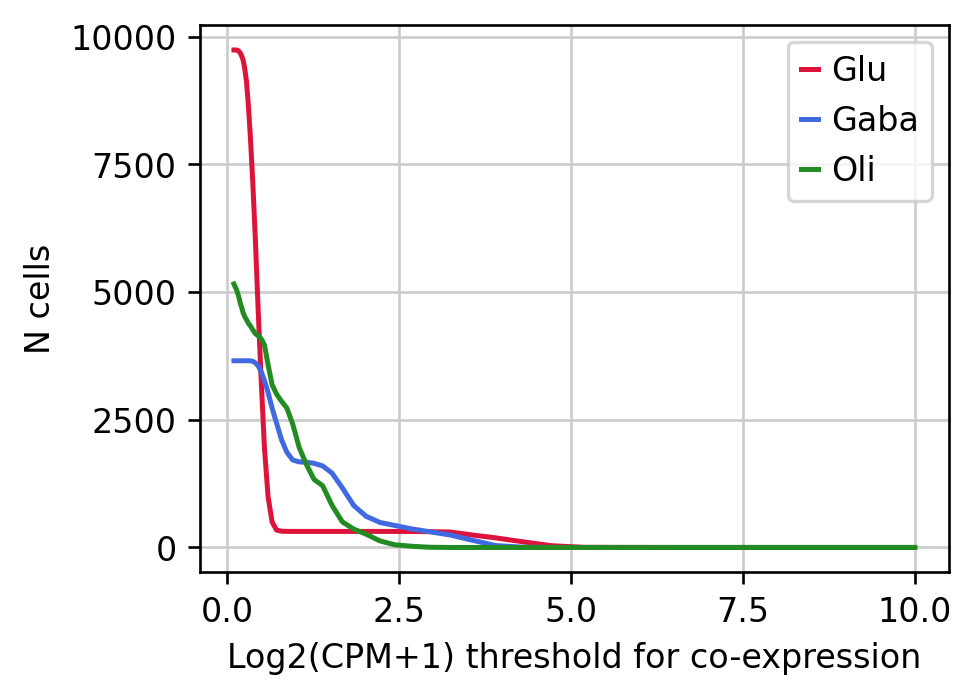

In [256]:
from matplotlib import pyplot as plt

#Plot N cells expressing celltype markers with increasing cutoff
fig,ax = plt.subplots(figsize=(4,3))
plt.plot(steps, glu_vec, label = 'Glu', c='crimson')
plt.plot(steps, gaba_vec, label = 'Gaba', c='royalblue')
plt.plot(steps, oli_vec, label = 'Oli', c='forestgreen')


#plt.xscale('log')
#plt.yscale('log')
plt.legend(fontsize=10)
plt.ylabel('N cells', size=10)
plt.xlabel('Log2(CPM+1) threshold for co-expression', size=10)
plt.xticks(size=10)
plt.yticks(size=10)
#plt.savefig('prac.svg')
plt.show()

# Quantify co-expression of Glu and Gaba

Gaba: ['Gad2', 'Gad1', 'Slc32a1']
Glu: ['Slc17a7', 'Slc17a6']


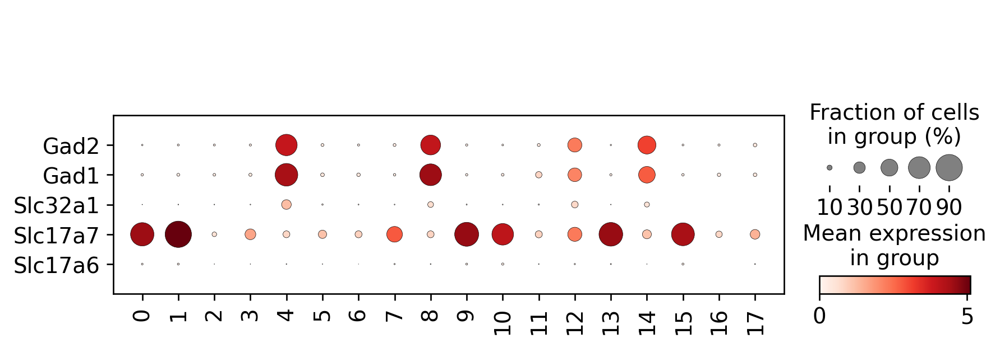

In [258]:
# Co-expression clusters?
print_l = gaba_mark,glu_mark
name_l = ['Gaba','Glu']
for x,i in enumerate(print_l):print(f'{name_l[x]}: {i}')

# Look at expression of Gaba, Glu and glial marker cells -> QC by
# How selective are cluster for Gaba only

#Dotplot of gene expression by
sc.pl.dotplot(fdata,var_names=list(gaba_mark+glu_mark),
              groupby='louvain',swap_axes=True)


4


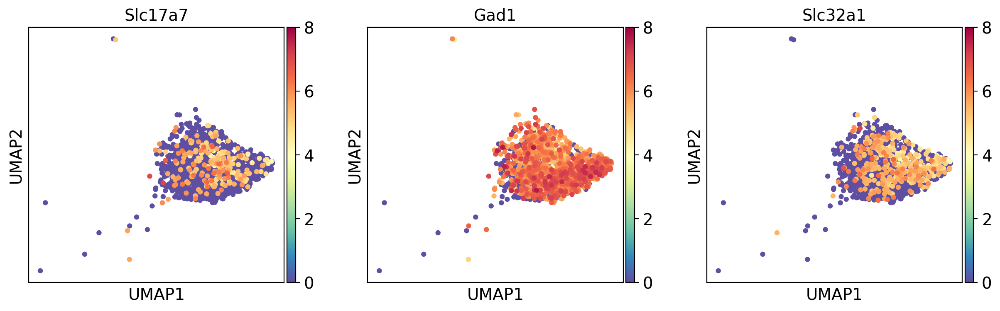

8


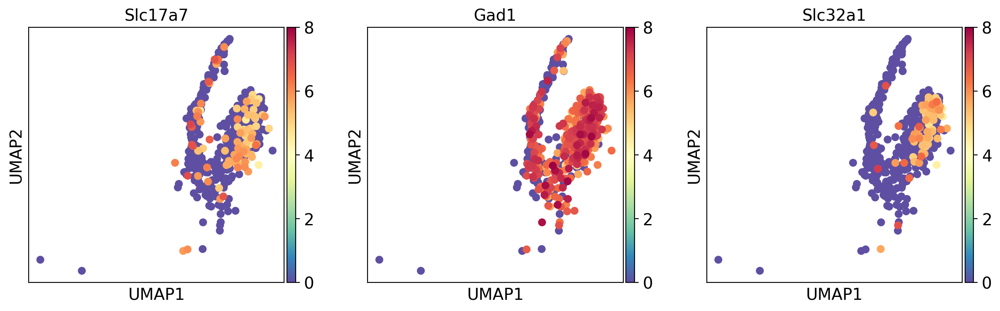

12


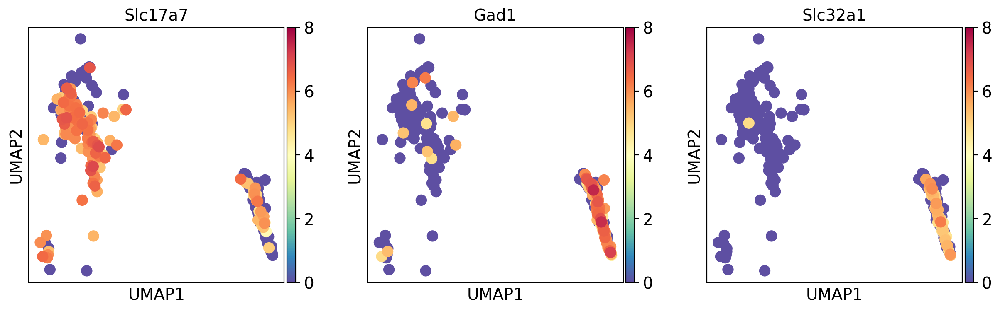

14


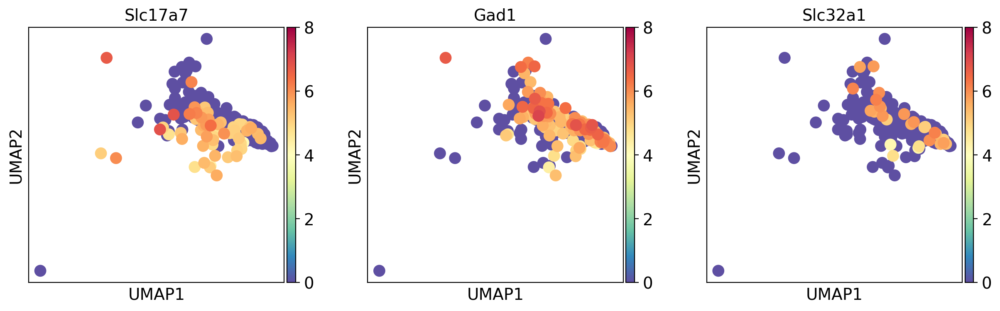

In [272]:
#Visualise each cluster

clust_list = [4,8,12,14]
for c in clust_list:
    print(c)
    curr_clust = fdata[fdata.obs['louvain'].values == str(c)]
    sc.set_figure_params(dpi=100)
    sc.pl.umap(curr_clust,color=['Slc17a7', 'Gad1', 'Slc32a1'],vmin=0, vmax=8,legend_loc='on data', cmap='Spectral_r')

In [275]:
(fdata.obs['mean_glu'] + fdata.obs['mean_gaba'])/2

AAACCCAAGAGATCGC-1    0.126216
AAACCCAAGAGCACTG-1    0.144425
AAACCCAAGGAGATAG-1    0.070837
AAACCCAAGGATCATA-1    0.693969
AAACCCAAGGGAGGAC-1    0.104679
                        ...   
TTTGTTGTCGTGGCGT-1   -0.428585
TTTGTTGTCTACGGTA-1    0.175090
TTTGTTGTCTTCCAGC-1    0.077765
TTTGTTGTCTTCTTCC-1    0.063145
TTTGTTGTCTTGTTAC-1    0.077288
Length: 19644, dtype: float32

In [285]:
#Go down to single cells

#Cluster 4 and 8
# What percentage of cells in cluster are co-expressing based on threshold

#calculate mean coexpression
fdata.obs['mean_coexp']  = (fdata.obs['mean_glu'] + fdata.obs['mean_gaba'])/2

#compute number of co-expressing vs singular as a function of cpm co-expression threshold
vec4, vec8, vec12, vec14 = [],[],[],[]
steps = (np.geomspace(0.1,10))
for i in steps:
    vec4.append(sum(fdata.obs['mean_coexp'][fdata.obs['louvain'] == str(4)] > i))
    vec8.append(sum(fdata.obs['mean_coexp'][fdata.obs['louvain'] == str(8)] > i))
    vec12.append(sum(fdata.obs['mean_coexp'][fdata.obs['louvain'] == str(12)] > i))
    vec14.append(sum(fdata.obs['mean_coexp'][fdata.obs['louvain'] == str(14)] > i))

In [289]:
sum(fdata.obs['louvain'] == str(4))

1503

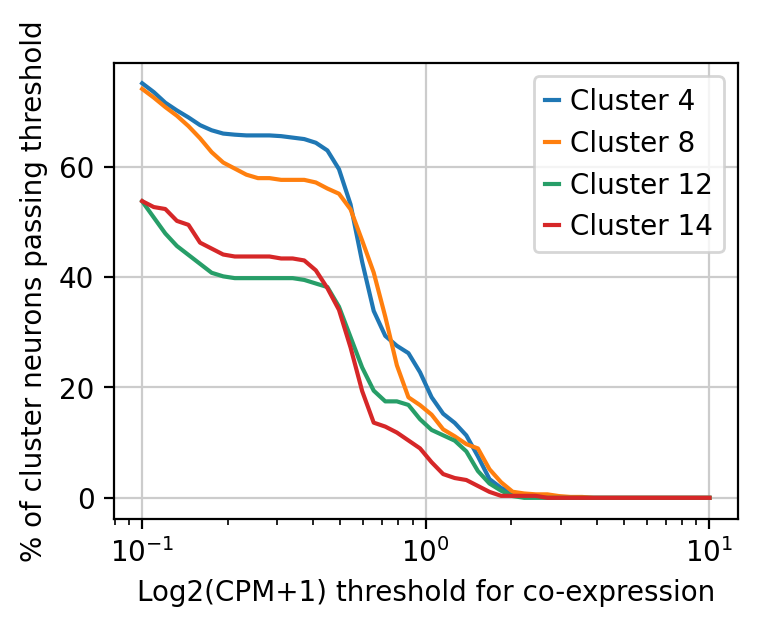

In [324]:
from matplotlib import pyplot as plt

#Plot N cells expressing celltype markers with increasing cutoff
fig,ax = plt.subplots(figsize=(4,3))
plt.plot(steps, (np.asarray(vec4)/sum(fdata.obs['louvain'] == str(4)))*100, label = 'Cluster 4')
plt.plot(steps, (np.asarray(vec8)/sum(fdata.obs['louvain'] == str(8)))*100, label = 'Cluster 8')
plt.plot(steps, (np.asarray(vec12)/sum(fdata.obs['louvain'] == str(12)))*100, label = 'Cluster 12')
plt.plot(steps, (np.asarray(vec14)/sum(fdata.obs['louvain'] == str(14)))*100, label = 'Cluster 14')


plt.xscale('log')
#plt.yscale('log')
plt.legend(fontsize=10)
plt.ylabel('% of cluster neurons passing threshold', size=10)
plt.xlabel('Log2(CPM+1) threshold for co-expression', size=10)
plt.xticks(size=10)
plt.yticks(size=10)
#plt.savefig('prac.svg')
plt.show()

In [297]:
sub_bool = (fdata.obs['louvain'] == '4') |  (fdata.obs['louvain'] == '8') | (fdata.obs['louvain'] == '12')| (fdata.obs['louvain'] == '14')
sub_bool

AAACCCAAGAGATCGC-1    False
AAACCCAAGAGCACTG-1    False
AAACCCAAGGAGATAG-1    False
AAACCCAAGGATCATA-1     True
AAACCCAAGGGAGGAC-1    False
                      ...  
TTTGTTGTCGTGGCGT-1    False
TTTGTTGTCTACGGTA-1    False
TTTGTTGTCTTCCAGC-1    False
TTTGTTGTCTTCTTCC-1     True
TTTGTTGTCTTGTTAC-1    False
Name: louvain, Length: 19644, dtype: bool

In [303]:
fdata.obs['mean_glu'][sub_bool]

AAACCCAAGGATCATA-1   -0.548791
AAACCCATCGGCTGTG-1   -0.548791
AAACGAAGTGTTAAAG-1   -0.548791
AAACGAATCGCATTAG-1    0.305631
AAACGAATCTGAATCG-1   -0.548791
                        ...   
TTTGTTGAGCTGAAAT-1   -0.548791
TTTGTTGAGTGCCGAA-1   -0.548791
TTTGTTGCAACGTTAC-1   -0.548791
TTTGTTGGTGGGACAT-1   -0.548791
TTTGTTGTCTTCTTCC-1   -0.548791
Name: mean_glu, Length: 2728, dtype: float32

In [ ]:
mean_glu = np.mean(sub_mat[:,glu_ind],axis=1)
mean_gaba = np.mean(sub_mat[:,gaba_ind],axis=1)

import seaborn as sns
df = pd.DataFrame({'glu': mean_glu, 'gaba': mean_gaba})
sns.jointplot(data=df, x='glu', y='gaba', kind='kde')
plt.show()

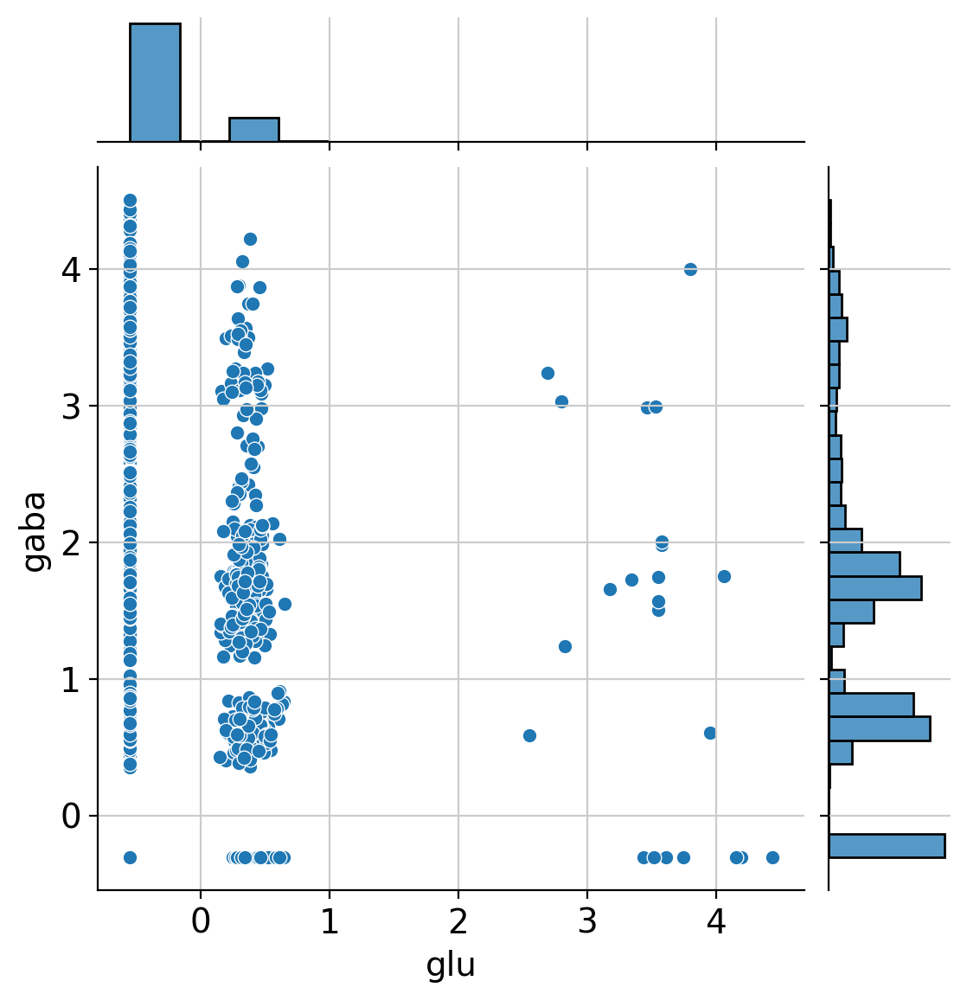

In [322]:
# Plot Glu vs Gaba 
# Direction of shift?

import seaborn as sns
df = pd.DataFrame({'glu': fdata.obs['mean_glu'][sub_bool], 'gaba': fdata.obs['mean_gaba'][sub_bool],
                  'cluster': fdata.obs['louvain'][sub_bool]})
sns.jointplot(data=df, x='glu', y='gaba'
             )#, ylim=(0,20000))
plt.show()

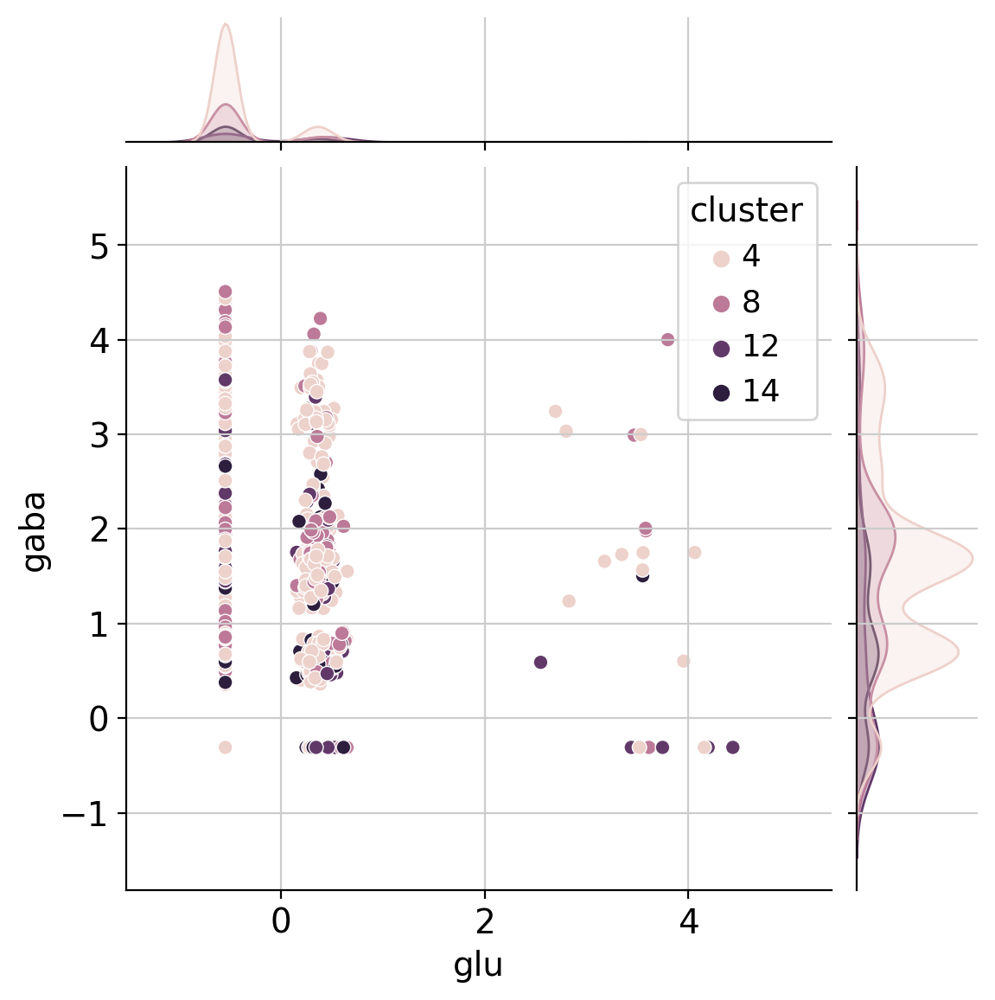

In [320]:
fdata.obs['louvain_int'] = fdata.obs['louvain'].cat.codes
# Plot Glu vs Gaba 
# Direction of shift?

import seaborn as sns
df = pd.DataFrame({'glu': fdata.obs['mean_glu'][sub_bool], 'gaba': fdata.obs['mean_gaba'][sub_bool],
                  'cluster': fdata.obs['louvain_int'][sub_bool]})
sns.jointplot(data=df, x='glu', y='gaba', hue = 'cluster')#, ylim=(0,20000))
plt.show()